# Final Project - Computer Vision
---
**Objectives**  
This computer vision project aims to build a model to classify car damage into six class: crack, dent, glass shatter, lamp broken, scratch, tire flat. 

# **Import Libraries**

In [93]:
# Define Libraries

import os
import glob
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import tensorflow as tf
from PIL import Image
import warnings

pd.options.display.max_columns = 200
warnings.filterwarnings('ignore')

# Feature Engineering
from sklearn.model_selection import train_test_split

# Model Evaluation
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, classification_report

# **Data Loading**

In [94]:
# Downloading the data from kaggle

# ! mkdir ~/.kaggle
# ! cp './kaggle.json' ~/.kaggle/
# ! chmod 600 '/Users/basyirasabita/.kaggle/kaggle.json'
# ! kaggle datasets download gauravduttakiit/vehicle-damage-identification

In [95]:
# ! unzip -q ./vehicle-damage-identification.zip

In [96]:
# Loading the train files path
train_files = glob.glob('./train/*')

train_files

['./train/dent',
 './train/crack',
 './train/scratch',
 './train/lamp broken',
 './train/glass shatter',
 './train/tire flat']

In [97]:
# Loading the test files path
test_files = glob.glob('./test/*')

test_files

['./test/dent',
 './test/crack',
 './test/scratch',
 './test/lamp broken',
 './test/glass shatter',
 './test/tire flat']

In [98]:
# Defining the labels for classification
labels = []
for folder in train_files:
    label = folder.split('/')[2] # Split the path and slice the label name
    labels.append(label)

labels

['dent', 'crack', 'scratch', 'lamp broken', 'glass shatter', 'tire flat']

In [99]:
# # Renaming the files by relevant labels
# for label in labels:
#     train_path = f'./train/{label}'
#     train_img_files = glob.glob(train_path + '/*')
#     num_train = 1
#     for img_file in train_img_files:
#       os.rename(img_file, f'{train_path}/{label}_' + "{:03d}".format(num_train) + '.jpg')
#       num_train += 1
#     print(f'last num_train of {label}: {num_train}')

#     test_path = f'./test/{label}'
#     test_img_files = glob.glob(test_path + '/*')
#     num_test = 1
#     for img_file in test_img_files:
#       os.rename(img_file, f'{test_path}/{label}_' + "{:03d}".format(num_test) + '.jpg')
#       num_test += 1
#     print(f'last num_test of {label}: {num_test}')

In [100]:
# Listing train images of each category
train_files_dict = {}
all_train_files = []

for label in labels:
    train_path = f'./train/{label}'
    train_img_files = glob.glob(train_path + '/*')
    train_img_files.sort()
    train_files_dict[f'{label}_train_files'] = train_img_files
    all_train_files.extend(train_img_files)

print(f'len all train files: {len(all_train_files)}')
print(all_train_files[-6:])

len all train files: 5760
['./train/tire flat/tire flat_422.jpg', './train/tire flat/tire flat_423.jpg', './train/tire flat/tire flat_424.jpg', './train/tire flat/tire flat_425.jpg', './train/tire flat/tire flat_426.jpg', './train/tire flat/tire flat_427.jpg']


In [101]:
# Listing test images of each category
test_files_dict = {}
all_test_files = []

for label in labels:
    test_path = f'./test/{label}'
    test_img_files = glob.glob(test_path + '/*')
    test_img_files.sort()
    test_files_dict[f'{label}_test_files'] = test_img_files
    all_test_files.extend(test_img_files)

print(f'len all test files: {len(all_test_files)}')
print(all_test_files[-6:])

len all test files: 1440
['./test/tire flat/tire flat_102.jpg', './test/tire flat/tire flat_103.jpg', './test/tire flat/tire flat_104.jpg', './test/tire flat/tire flat_105.jpg', './test/tire flat/tire flat_106.jpg', './test/tire flat/tire flat_107.jpg']


In [102]:
# Create a Pandas DataFrame that contains the path of all train images
all_labels = []
for label in labels:
    train_files = train_files_dict[f'{label}_train_files']
    temp = [f'{label}' for i in range(len(train_files))]
    all_labels.extend(temp)

train_img_df = pd.DataFrame({
    'images':all_train_files, 'label':all_labels
})

train_img_df

,images,label
0,./train/dent/dent_001.jpg,dent
1,./train/dent/dent_002.jpg,dent
2,./train/dent/dent_003.jpg,dent
3,./train/dent/dent_004.jpg,dent
4,./train/dent/dent_005.jpg,dent
...,...,...
5755,./train/tire flat/tire flat_423.jpg,tire flat
5756,./train/tire flat/tire flat_424.jpg,tire flat
5757,./train/tire flat/tire flat_425.jpg,tire flat
5758,./train/tire flat/tire flat_426.jpg,tire flat


In [103]:
# Create a Pandas DataFrame that contains the path of all test images
all_labels = []
for label in labels:
    test_files = test_files_dict[f'{label}_test_files']
    temp = [f'{label}' for i in range(len(test_files))]
    all_labels.extend(temp)

test_img_df = pd.DataFrame({
    'images':all_test_files, 'label':all_labels
})

test_img_df

,images,label
0,./test/dent/dent_001.jpg,dent
1,./test/dent/dent_002.jpg,dent
2,./test/dent/dent_003.jpg,dent
3,./test/dent/dent_004.jpg,dent
4,./test/dent/dent_005.jpg,dent
...,...,...
1435,./test/tire flat/tire flat_103.jpg,tire flat
1436,./test/tire flat/tire flat_104.jpg,tire flat
1437,./test/tire flat/tire flat_105.jpg,tire flat
1438,./test/tire flat/tire flat_106.jpg,tire flat


# **Exploratory Data Analysis**

## EDA Functions

In [104]:
# Function to plot numeric distribution (histogram & boxplot)
def plot_distribution(df, col, colName, color = 'indianred'):
    plt.figure(figsize=(7,3))

    # Plot Histogram
    plt.subplot(1, 2, 1)
    sns.histplot(data=df[col], kde=True, color=color, bins=20)
    plt.title('Histogram')

    # Boxplot
    plt.subplot(1, 2, 2)
    sns.boxplot(data=df, x=col, color=color)
    plt.title('Boxplot')

    plt.suptitle(f'{colName} Distribution')
    plt.show()

In [105]:
# Function to get the label and its count
def label_proportion(df):
    label_count = df.groupby('label')['label'].count().sort_values(ascending=False)

    labels = label_count.index.to_list()
    counts = label_count.to_list()

    return labels, counts

## Label Proportion

In [106]:
# Get label proportion of image dataframe
labels, counts = label_proportion(train_img_df)

# Save the label and counts into Dataframe
label_df = pd.DataFrame({
    'label': labels,
    'count': counts
})

label_df

,label,count
0,scratch,1879
1,dent,1663
2,glass shatter,948
3,lamp broken,706
4,tire flat,427
5,crack,137


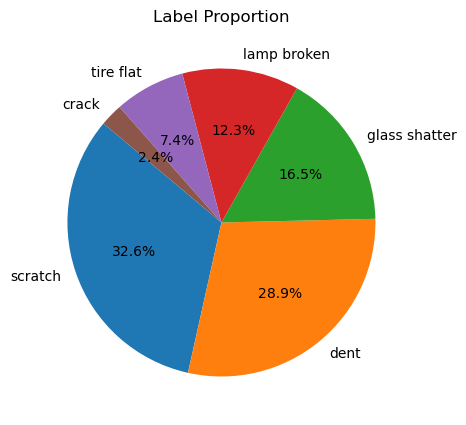

In [107]:
# Piechart
plt.figure(figsize=(5,5))
plt.pie(label_df['count'], labels=labels, autopct='%1.1f%%', startangle=140)
plt.title('Label Proportion')

plt.show()

## Image Sizes

In [108]:
# Get all file size in kb
all_file_sizes = []
for label in labels:
    files = train_files_dict[f'{label}_train_files']

    for i in range(len(files)):
        temp_path = files[i]
        size = os.path.getsize(temp_path) / 1024 # bytes to kb
        all_file_sizes.append(round(size,3))

# Save the file sizes to the image dataframe
train_img_df['size_kb'] = all_file_sizes

train_img_df

,images,label,size_kb
0,./train/dent/dent_001.jpg,dent,66.516
1,./train/dent/dent_002.jpg,dent,131.299
2,./train/dent/dent_003.jpg,dent,79.368
3,./train/dent/dent_004.jpg,dent,92.950
4,./train/dent/dent_005.jpg,dent,53.982
...,...,...,...
5755,./train/tire flat/tire flat_423.jpg,tire flat,91.457
5756,./train/tire flat/tire flat_424.jpg,tire flat,121.474
5757,./train/tire flat/tire flat_425.jpg,tire flat,70.176
5758,./train/tire flat/tire flat_426.jpg,tire flat,90.760


In [109]:
# Describing the size columns
train_img_df.describe()

,size_kb
count,5760.000000
mean,129.991642
std,67.843720
min,37.812000
25%,79.783500
50%,113.270000
75%,155.451750
max,430.297000


### Image Size Distribution

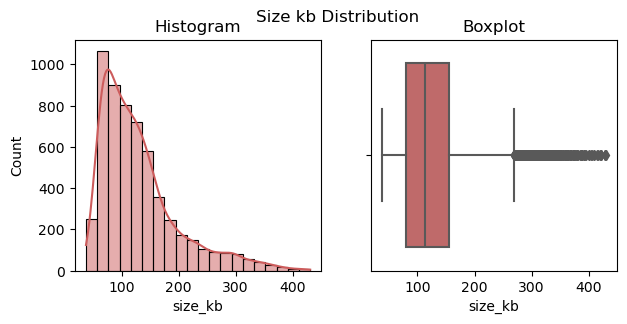

In [110]:
plot_distribution(train_img_df, 'size_kb', 'Size kb')

### Display Small Images

In [111]:
small_train_img_df = train_img_df[train_img_df['size_kb'] <= 50]
small_train_img_df = small_train_img_df.sample(len(small_train_img_df)).reset_index(drop=True).head(5)

small_train_img_df

,images,label,size_kb
0,./train/glass shatter/glass shatter_053.jpg,glass shatter,42.648
1,./train/lamp broken/lamp broken_302.jpg,lamp broken,43.905
2,./train/scratch/scratch_1194.jpg,scratch,49.218
3,./train/scratch/scratch_1098.jpg,scratch,48.483
4,./train/scratch/scratch_1066.jpg,scratch,46.867


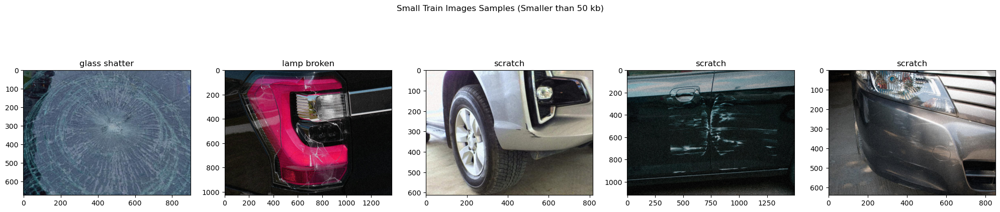

In [112]:
# Define the subplots for displaying images
fig, axes = plt.subplots(ncols=5, nrows= 1, figsize=(20,5))

# Saving the data to list
small_train_files = small_train_img_df['images'].to_list()
small_train_file_labels = small_train_img_df['label'].to_list()

# Iterate for every axes
for i in range(5):
    img = plt.imread(small_train_files[i])
    axes[i].imshow(img)
    axes[i].set_title(small_train_file_labels[i])

# Property of the plots
fig.suptitle('Small Train Images Samples (Smaller than 50 kb)')
fig.tight_layout()
plt.show()

### Display Large Images

In [113]:
large_train_img_df = train_img_df[train_img_df['size_kb'] >= 400]
large_train_img_df = large_train_img_df.sample(len(large_train_img_df)).reset_index(drop=True).head(5)

large_train_img_df

,images,label,size_kb
0,./train/dent/dent_1063.jpg,dent,428.884
1,./train/lamp broken/lamp broken_493.jpg,lamp broken,406.505
2,./train/scratch/scratch_304.jpg,scratch,400.932
3,./train/scratch/scratch_168.jpg,scratch,422.167
4,./train/glass shatter/glass shatter_094.jpg,glass shatter,413.815


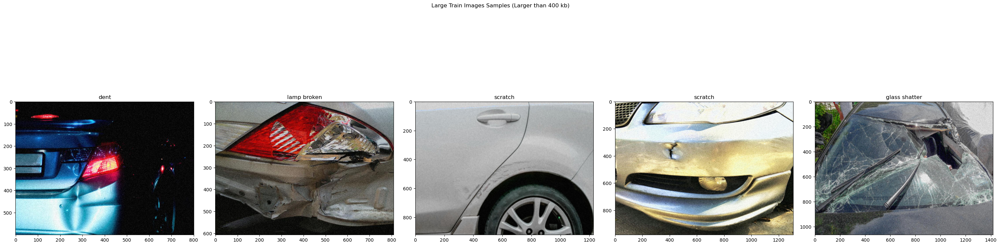

In [116]:
# Define the subplots for displaying images
fig, axes = plt.subplots(ncols=5, nrows= 1, figsize=(30,10))

# Saving the data to list
large_train_files = large_train_img_df['images'].to_list()
large_train_file_labels = large_train_img_df['label'].to_list()

# Iterate for every axes
for i in range(5):
    img = plt.imread(large_train_files[i])
    axes[i].imshow(img)
    axes[i].set_title(large_train_file_labels[i])

# Property of the plots
fig.suptitle('Large Train Images Samples (Larger than 400 kb)')
fig.tight_layout()
plt.show()

## Image Dimensions

In [117]:
# Get all image dimensions
all_train_dimensions = []
all_train_widths = []
all_train_heights = []
for label in labels:
    files = train_files_dict[f'{label}_train_files']

    for i in range(len(files)):
        temp_path = files[i]
        dimension = (0,0)
        try:
            with Image.open(temp_path) as img:
                dimension = img.size
        except Exception as e:
            print(f"Error reading image {temp_path}: {e}")
        width, height = dimension[0], dimension[1]
        all_train_dimensions.append(dimension)
        all_train_widths.append(width)
        all_train_heights.append(height)

# Save the image dimensions to the image dataframe
train_img_df['dimensions'] = all_train_dimensions

train_img_df

,images,label,size_kb,dimensions
0,./train/dent/dent_001.jpg,dent,66.516,"(878, 658)"
1,./train/dent/dent_002.jpg,dent,131.299,"(1383, 1037)"
2,./train/dent/dent_003.jpg,dent,79.368,"(877, 657)"
3,./train/dent/dent_004.jpg,dent,92.950,"(810, 607)"
4,./train/dent/dent_005.jpg,dent,53.982,"(802, 601)"
...,...,...,...,...
5755,./train/tire flat/tire flat_423.jpg,tire flat,91.457,"(1130, 847)"
5756,./train/tire flat/tire flat_424.jpg,tire flat,121.474,"(894, 670)"
5757,./train/tire flat/tire flat_425.jpg,tire flat,70.176,"(875, 656)"
5758,./train/tire flat/tire flat_426.jpg,tire flat,90.760,"(849, 636)"


In [118]:
# Saving the dimensions into dataframe
train_dimension_df = pd.DataFrame({
    'dimensions': all_train_dimensions,
    'width': all_train_widths,
    'height': all_train_heights
})

train_dimension_df

,dimensions,width,height
0,"(878, 658)",878,658
1,"(1383, 1037)",1383,1037
2,"(877, 657)",877,657
3,"(810, 607)",810,607
4,"(802, 601)",802,601
...,...,...,...
5755,"(1130, 847)",1130,847
5756,"(894, 670)",894,670
5757,"(875, 656)",875,656
5758,"(849, 636)",849,636


### Width Distribution

In [119]:
train_dimension_df['width'].describe().to_frame().T

,count,mean,std,min,25%,50%,75%,max
width,5760.0,1076.043403,239.433179,800.0,851.0,1101.5,1299.0,1500.0


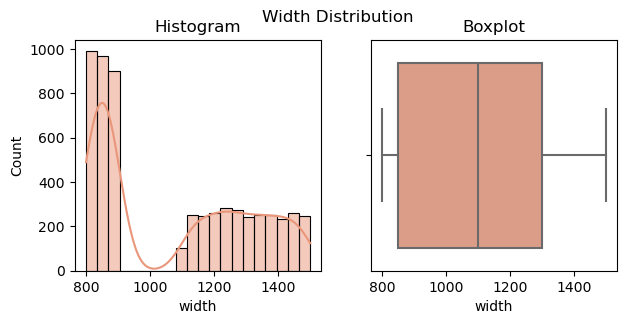

In [120]:
plot_distribution(train_dimension_df, 'width', 'Width', 'darksalmon')

### Height Distribution

In [121]:
train_dimension_df['height'].describe().to_frame().T

,count,mean,std,min,25%,50%,75%,max
height,5760.0,806.66441,179.577154,600.0,638.0,825.5,974.0,1125.0


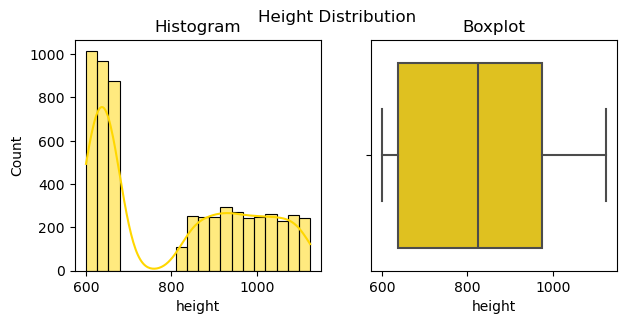

In [122]:
plot_distribution(train_dimension_df, 'height', 'Height', 'gold')

## Display Images

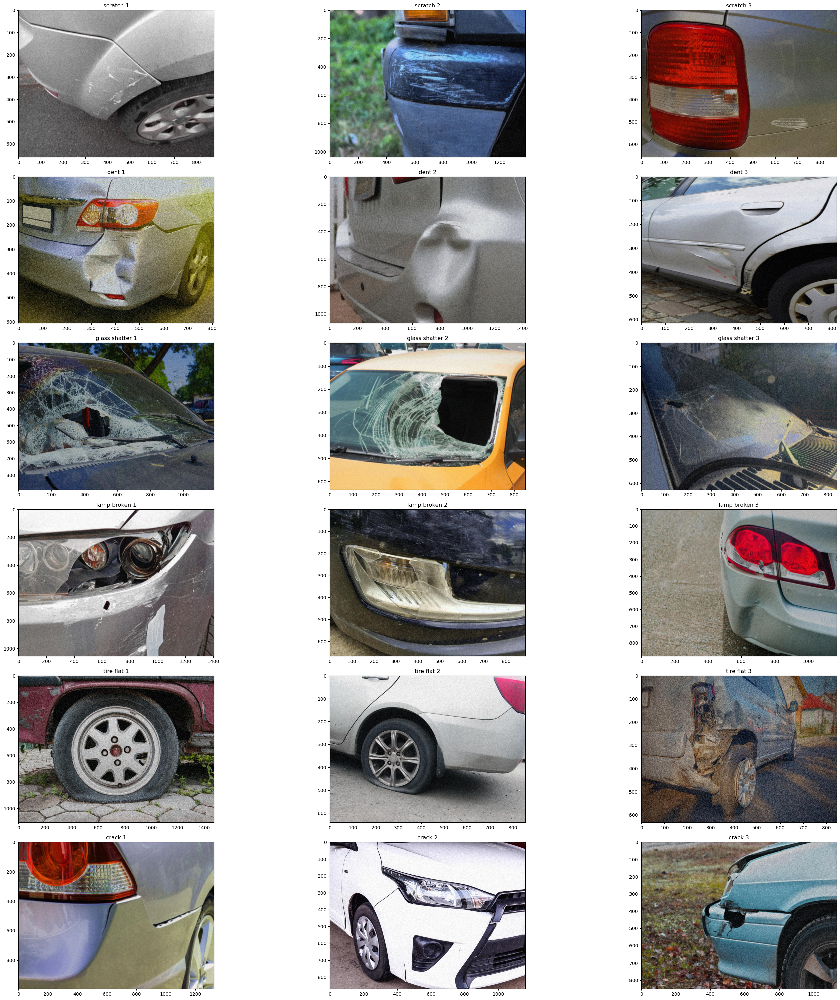

In [123]:
# Show preview images in each category

fig, axes = plt.subplots(ncols=3, nrows=6, figsize=(30,30))

# Iterate over each label
for i in range(len(labels)):
    label = labels[i]
    # print(label)
    samples = train_files_dict[f'{label}_train_files'][:3]

    # Iterate over each sample for the current label
    for j in range(len(samples)):
        img = plt.imread(samples[j])
        axes[i, j].imshow(img)
        axes[i, j].set_title(f'{label} {j+1}')

fig.tight_layout()
plt.show()

In [124]:
# Saving the dataframe
train_dimension_df.to_csv('deployment/content/dimension.csv', index=False)
train_img_df.to_csv('deployment/content/img.csv', index=False)

# **Feature Engineering**

## Split Train, Validation, and Test Set

In [125]:
# Randomize the order of the train data
train_df = train_img_df.sample(len(train_img_df)).reset_index(drop=True)

train_df

,images,label,size_kb,dimensions
0,./train/dent/dent_1597.jpg,dent,130.995,"(892, 669)"
1,./train/scratch/scratch_036.jpg,scratch,121.271,"(1348, 1011)"
2,./train/dent/dent_704.jpg,dent,125.436,"(1136, 852)"
3,./train/lamp broken/lamp broken_106.jpg,lamp broken,62.486,"(816, 612)"
4,./train/scratch/scratch_1869.jpg,scratch,63.229,"(812, 609)"
...,...,...,...,...
5755,./train/scratch/scratch_896.jpg,scratch,139.150,"(884, 663)"
5756,./train/dent/dent_217.jpg,dent,79.740,"(862, 646)"
5757,./train/scratch/scratch_775.jpg,scratch,71.369,"(805, 603)"
5758,./train/scratch/scratch_517.jpg,scratch,132.767,"(1264, 948)"


In [126]:
# Randomize the order of the test data
test_img_df = test_img_df.sample(len(test_img_df)).reset_index(drop=True)

test_img_df

,images,label
0,./test/scratch/scratch_394.jpg,scratch
1,./test/tire flat/tire flat_042.jpg,tire flat
2,./test/dent/dent_262.jpg,dent
3,./test/glass shatter/glass shatter_064.jpg,glass shatter
4,./test/dent/dent_018.jpg,dent
...,...,...
1435,./test/tire flat/tire flat_036.jpg,tire flat
1436,./test/scratch/scratch_306.jpg,scratch
1437,./test/glass shatter/glass shatter_148.jpg,glass shatter
1438,./test/dent/dent_063.jpg,dent


In [127]:
# Split into train and val set
test_df, val_df = train_test_split(test_img_df, test_size=0.4, random_state=123, stratify=test_img_df['label'])

print(f'Train shape: {train_df.shape}')
print(f'Val shape: {val_df.shape}')
print(f'Test shape: {test_df.shape}')

Train shape: (5760, 4)
Val shape: (576, 2)
Test shape: (864, 2)


In [128]:
# Get label proportion for each sets
labels, counts_train = label_proportion(train_df)
labels, counts_val = label_proportion(val_df)
labels, counts_test = label_proportion(test_df)

# Save the label proportion into a dataframe
label_proportion_df = pd.DataFrame({
    'label': labels,
    'train': counts_train,
    'val': counts_val,
    'test': counts_test,
})

label_proportion_df

,label,train,val,test
0,scratch,1879,188,282
1,dent,1663,166,250
2,glass shatter,948,95,142
3,lamp broken,706,70,106
4,tire flat,427,43,64
5,crack,137,14,20


## Image Data Generator

Found 5760 validated image filenames belonging to 6 classes.


Indices: {'crack': 0, 'dent': 1, 'glass shatter': 2, 'lamp broken': 3, 'scratch': 4, 'tire flat': 5}


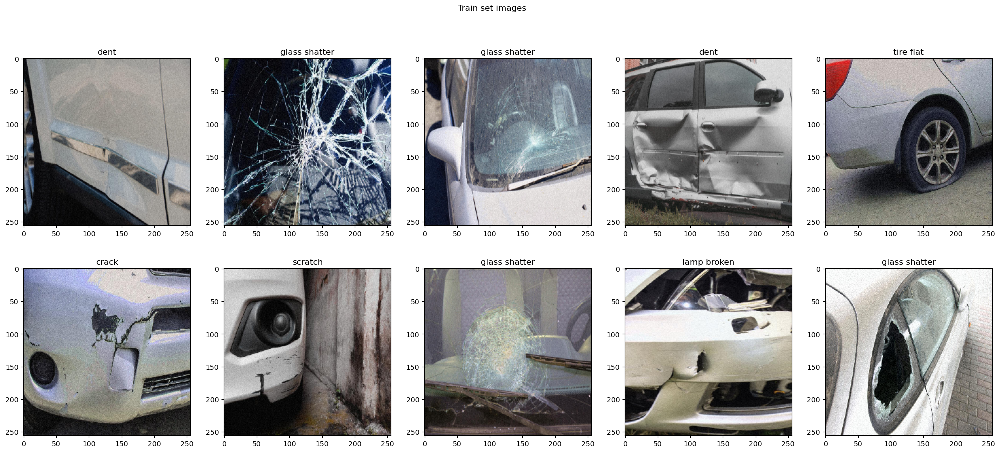

In [129]:
# Train Image Data Generator
train_datagen = tf.keras.preprocessing.image.ImageDataGenerator(rescale=1./255.)

# Flow from dataframe
train_gen = train_datagen.flow_from_dataframe(
	  train_df,
    x_col='images',
    y_col='label',
    # target_size=(150, 150),
	  class_mode='categorical',
	  shuffle=False
)

label_indices = train_gen.class_indices
classes= list(label_indices.keys())

print(f'Indices: {label_indices}')

# Show images of train-set
fig, ax = plt.subplots(nrows=2, ncols=5, figsize=(25,10))
n = 0

for i in range(2):
  for j in range(5):
    img, label = train_gen.next()
    idx = np.argmax(label, axis=1)  # Get the index of the maximum value in each label
    class_names = [classes[i] for i in idx]  # Get the class names for the corresponding indices
    
    # Display the image along with its label
    ax[i][j].imshow(img[0])  
    ax[i][j].set_title(class_names[0])

fig.suptitle('Train set images')
plt.show()

Found 576 validated image filenames belonging to 6 classes.
Indices: {'crack': 0, 'dent': 1, 'glass shatter': 2, 'lamp broken': 3, 'scratch': 4, 'tire flat': 5}


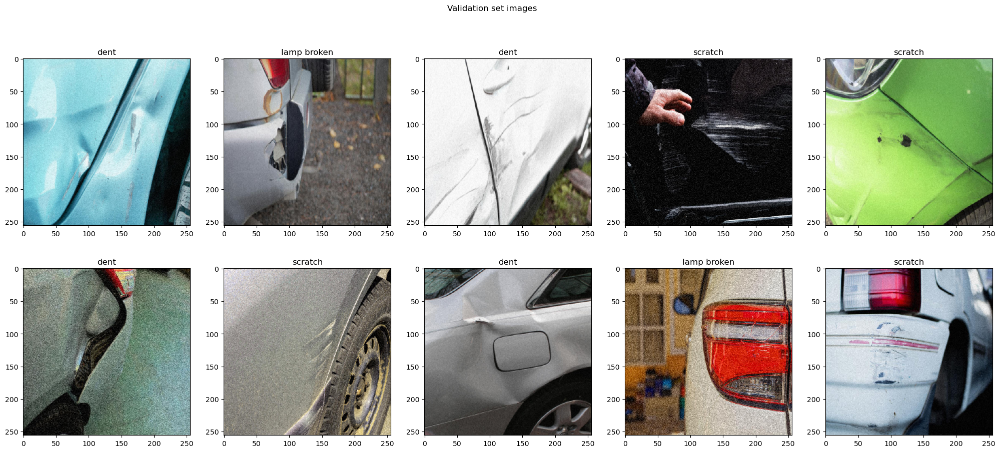

In [130]:
# Validation Image Data Generator
val_datagen = tf.keras.preprocessing.image.ImageDataGenerator(rescale=1./255.)

# Flow from dataframe
val_gen = val_datagen.flow_from_dataframe(
	val_df,
    x_col='images',
    y_col='label',
    # target_size=(150, 150),
	class_mode='categorical',
	shuffle=False
)

label_indices = val_gen.class_indices
classes= list(label_indices.keys())

print(f'Indices: {label_indices}')

# Show images of val-set
fig, ax = plt.subplots(nrows=2, ncols=5, figsize=(25,10))
n = 0

for i in range(2):
  for j in range(5):
    img, label = val_gen.next()
    idx = np.argmax(label, axis=1)  # Get the index of the maximum value in each label
    class_names = [classes[i] for i in idx]  # Get the class names for the corresponding indices
    
    # Display the image along with its label
    ax[i][j].imshow(img[0])  
    ax[i][j].set_title(class_names[0])

fig.suptitle('Validation set images')
plt.show()

Found 864 validated image filenames belonging to 6 classes.
Indices: {'crack': 0, 'dent': 1, 'glass shatter': 2, 'lamp broken': 3, 'scratch': 4, 'tire flat': 5}


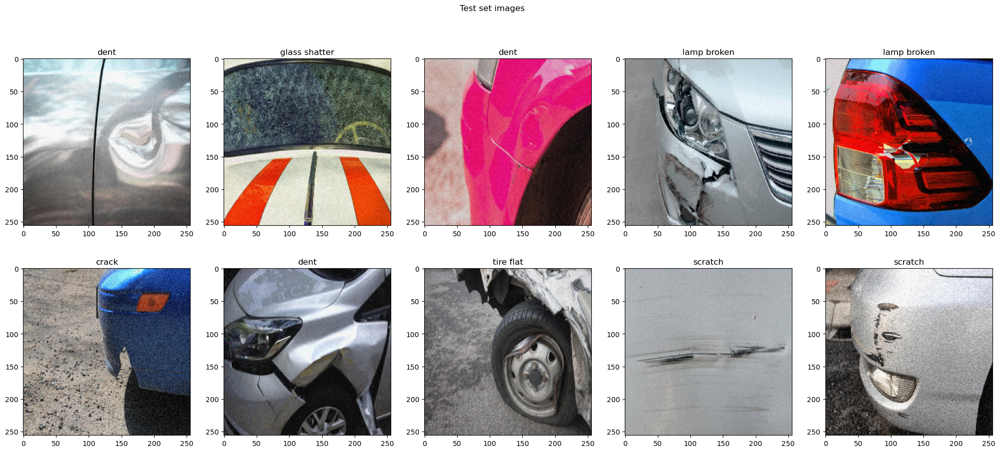

In [131]:
# Test Image Data Generator
test_datagen = tf.keras.preprocessing.image.ImageDataGenerator(rescale=1./255.)

# Flow from dataframe
test_gen = test_datagen.flow_from_dataframe(
	  test_df,
    x_col='images',
    y_col='label',
    # target_size=(150, 150),
	  class_mode='categorical',
	  shuffle=False
)

label_indices = test_gen.class_indices
classes= list(label_indices.keys())

print(f'Indices: {label_indices}')

# Show images of test-set
fig, ax = plt.subplots(nrows=2, ncols=5, figsize=(25,10))
n = 0

for i in range(2):
  for j in range(5):
    img, label = test_gen.next()
    idx = np.argmax(label, axis=1)  # Get the index of the maximum value in each label
    class_names = [classes[i] for i in idx]  # Get the class names for the corresponding indices
    
    # Display the image along with its label
    ax[i][j].imshow(img[0])  
    ax[i][j].set_title(class_names[0])

fig.suptitle('Test set images')
plt.show()